<div class="alert alert-block alert-success"><h1><center><strong>C-VIX指数预测的对比研究——基于LSTM模型</strong><span class="tocSkip"></span><center></h1></div>

<h1>目录<span class="tocSkip"></span></h1>
<div class="toc"><ul class="toc-item"><li><span><a href="#环境设置" data-toc-modified-id="环境设置-1"><span class="toc-item-num">1&nbsp;&nbsp;</span>环境设置</a></span></li><li><span><a href="#数据概览" data-toc-modified-id="数据概览-2"><span class="toc-item-num">2&nbsp;&nbsp;</span>数据概览</a></span><ul class="toc-item"><li><span><a href="#数据来源" data-toc-modified-id="数据来源-2.1"><span class="toc-item-num">2.1&nbsp;&nbsp;</span>数据来源</a></span></li><li><span><a href="#数据处理" data-toc-modified-id="数据处理-2.2"><span class="toc-item-num">2.2&nbsp;&nbsp;</span>数据处理</a></span><ul class="toc-item"><li><span><a href="#数值型数据" data-toc-modified-id="数值型数据-2.2.1"><span class="toc-item-num">2.2.1&nbsp;&nbsp;</span>数值型数据</a></span></li><li><span><a href="#文本型数据" data-toc-modified-id="文本型数据-2.2.2"><span class="toc-item-num">2.2.2&nbsp;&nbsp;</span>文本型数据</a></span></li></ul></li><li><span><a href="#文本情绪分析(请勿跑）" data-toc-modified-id="文本情绪分析(请勿跑）-2.3"><span class="toc-item-num">2.3&nbsp;&nbsp;</span>文本情绪分析(请勿跑）</a></span><ul class="toc-item"><li><span><a href="#数据翻译" data-toc-modified-id="数据翻译-2.3.1"><span class="toc-item-num">2.3.1&nbsp;&nbsp;</span>数据翻译</a></span></li><li><span><a href="#Finbert情绪分析" data-toc-modified-id="Finbert情绪分析-2.3.2"><span class="toc-item-num">2.3.2&nbsp;&nbsp;</span>Finbert情绪分析</a></span></li></ul></li><li><span><a href="#描述性统计" data-toc-modified-id="描述性统计-2.4"><span class="toc-item-num">2.4&nbsp;&nbsp;</span>描述性统计</a></span><ul class="toc-item"><li><span><a href="#特征走势" data-toc-modified-id="特征走势-2.4.1"><span class="toc-item-num">2.4.1&nbsp;&nbsp;</span>特征走势</a></span></li><li><span><a href="#特征分布" data-toc-modified-id="特征分布-2.4.2"><span class="toc-item-num">2.4.2&nbsp;&nbsp;</span>特征分布</a></span></li><li><span><a href="#特征相关性" data-toc-modified-id="特征相关性-2.4.3"><span class="toc-item-num">2.4.3&nbsp;&nbsp;</span>特征相关性</a></span></li></ul></li></ul></li><li><span><a href="#数据预处理" data-toc-modified-id="数据预处理-3"><span class="toc-item-num">3&nbsp;&nbsp;</span>数据预处理</a></span><ul class="toc-item"><li><span><a href="#特征提取" data-toc-modified-id="特征提取-3.1"><span class="toc-item-num">3.1&nbsp;&nbsp;</span>特征提取</a></span></li><li><span><a href="#标准化" data-toc-modified-id="标准化-3.2"><span class="toc-item-num">3.2&nbsp;&nbsp;</span>标准化</a></span></li><li><span><a href="#分割数据" data-toc-modified-id="分割数据-3.3"><span class="toc-item-num">3.3&nbsp;&nbsp;</span>分割数据</a></span></li></ul></li><li><span><a href="#模型构建" data-toc-modified-id="模型构建-4"><span class="toc-item-num">4&nbsp;&nbsp;</span>模型构建</a></span><ul class="toc-item"><li><span><a href="#神经网络框架" data-toc-modified-id="神经网络框架-4.1"><span class="toc-item-num">4.1&nbsp;&nbsp;</span>神经网络框架</a></span></li><li><span><a href="#调节参数" data-toc-modified-id="调节参数-4.2"><span class="toc-item-num">4.2&nbsp;&nbsp;</span>调节参数</a></span><ul class="toc-item"><li><span><a href="#未降维情况调参" data-toc-modified-id="未降维情况调参-4.2.1"><span class="toc-item-num">4.2.1&nbsp;&nbsp;</span>未降维情况调参</a></span></li><li><span><a href="#进一步细致调参" data-toc-modified-id="进一步细致调参-4.2.2"><span class="toc-item-num">4.2.2&nbsp;&nbsp;</span>进一步细致调参</a></span></li><li><span><a href="#降维情况调参" data-toc-modified-id="降维情况调参-4.2.3"><span class="toc-item-num">4.2.3&nbsp;&nbsp;</span>降维情况调参</a></span></li></ul></li><li><span><a href="#模型优化" data-toc-modified-id="模型优化-4.3"><span class="toc-item-num">4.3&nbsp;&nbsp;</span>模型优化</a></span></li></ul></li><li><span><a href="#模型评估" data-toc-modified-id="模型评估-5"><span class="toc-item-num">5&nbsp;&nbsp;</span>模型评估</a></span><ul class="toc-item"><li><span><a href="#未降维模型结果" data-toc-modified-id="未降维模型结果-5.1"><span class="toc-item-num">5.1&nbsp;&nbsp;</span>未降维模型结果</a></span></li><li><span><a href="#降维模型结果" data-toc-modified-id="降维模型结果-5.2"><span class="toc-item-num">5.2&nbsp;&nbsp;</span>降维模型结果</a></span></li></ul></li><li><span><a href="#模型应用" data-toc-modified-id="模型应用-6"><span class="toc-item-num">6&nbsp;&nbsp;</span>模型应用</a></span></li></ul></div>

# 环境设置

In [3]:
#导入扩展库
import numpy as np
import pandas as pd
import seaborn as sns
from matplotlib import pyplot as plt
import matplotlib.ticker as ticker
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM
from tensorflow.keras.layers import Dense, Dropout
from tensorflow.config.experimental import list_physical_devices
from sklearn.preprocessing import MinMaxScaler,StandardScaler
from sklearn.model_selection import GridSearchCV
from keras.wrappers.scikit_learn import KerasRegressor
from sklearn import preprocessing
from sklearn import decomposition

In [4]:
import warnings
warnings.filterwarnings('ignore')

In [5]:
print("Num GPUs Available: ", len(list_physical_devices('GPU')))
#目前电脑CUDA版本过新

Num GPUs Available:  0


In [6]:
#设置字体和显示中文
plt.rcParams['font.sans-serif'] = ['SimHei']
plt.rcParams['axes.unicode_minus'] = False
plt.rcParams["font.weight"] = "medium"
plt.rcParams["axes.labelweight"] = "bold"

# 数据概览

## 数据来源

## 数据处理

### 数值型数据

In [7]:
#导入数据
cvix = pd.read_excel("C-VIX 2015-02-09至今.xlsx")
choicedata = pd.read_excel("ChoiceData.xlsx")
goldmarket = pd.read_excel("GoldMarket.xlsx")
famafrench = pd.read_excel("FamaFrenchFactors.xlsx")

In [8]:
#数据合并及指标计算
goldmarket['交易日期'] = pd.to_datetime(goldmarket['交易日期'])
famafrench['交易日期'] = pd.to_datetime(famafrench['交易日期'])
choicedata['交易日期'] = pd.to_datetime(choicedata['交易日期'])
cvix.columns = ['交易日期','上证50ETF波动率指数','上证50ETF偏度']
cvix['交易日期'] = pd.to_datetime(cvix['交易日期'])
cvix.set_index('交易日期',inplace=True)
data = choicedata
data.set_index('交易日期',inplace=True)

gold = pd.DataFrame()
gold.index = pd.to_datetime(goldmarket['交易日期'])
gold['平均收盘价（元）'] = goldmarket.groupby('交易日期')['收盘价（元）'].sum()/goldmarket.groupby('交易日期')['收盘价（元）'].count()
gold['平均涨跌幅（%）'] = goldmarket.groupby('交易日期')['涨跌幅（%）'].sum()/goldmarket.groupby('交易日期')['涨跌幅（%）'].count()
gold['平均成交量（千克）'] = goldmarket.groupby('交易日期')['成交量（千克）'].sum()/goldmarket.groupby('交易日期')['成交量（千克）'].count()
gold.drop_duplicates(inplace=True)

fffactors = pd.DataFrame()
fffactors.index = pd.to_datetime(famafrench['交易日期'])
fffactors['平均市场风险溢价因子'] = famafrench.groupby('交易日期')['市场风险溢价因子'].sum()/famafrench.groupby('交易日期')['市场风险溢价因子'].count()
fffactors['平均市值因子'] = famafrench.groupby('交易日期')['市值因子'].sum()/famafrench.groupby('交易日期')['市值因子'].count()
fffactors['平均账面市值比因子'] = famafrench.groupby('交易日期')['账面市值比因子'].sum()/famafrench.groupby('交易日期')['账面市值比因子'].count()
fffactors.drop_duplicates(inplace=True)

data['平均市场风险溢价因子'] = fffactors['平均市场风险溢价因子']
data['平均市值因子'] = fffactors['平均市值因子']
data['平均账面市值比因子'] = fffactors['平均账面市值比因子']
data['黄金平均收盘价（元）'] = gold['平均收盘价（元）']
data['黄金平均涨跌幅（%）'] = gold['平均涨跌幅（%）']
data['黄金平均成交量（千克）'] = gold['平均成交量（千克）']
data['上证50ETF波动率指数'] = cvix['上证50ETF波动率指数']
data.to_excel('data_raw.xlsx')

In [9]:
#缺失值处理
data1 = data.drop(data.tail(3).index) 
#print(data1.isnull().sum())
data2 = data1.interpolate()
#print(data2.isnull().sum())
data2.to_excel('data_bf_std.xlsx')

In [10]:
#数据去噪
rolling_days = 5 #取平均的天数
data3 = data2.copy()
data3_columns = data3.columns.tolist()
for i in data3_columns:
    data3['{}{}天均值'.format(i,rolling_days)]=data3[i].rolling(rolling_days).mean()

In [11]:
#标准化（除了目标变量）
data4 = pd.DataFrame()
data4.index = data3.index
for i in data3.columns:
    data4[i] = preprocessing.scale(data3[i])
data4.drop(columns=['上证50ETF波动率指数'])
data4['上证50ETF波动率指数'] = data3['上证50ETF波动率指数']
data4['上证50ETF波动率指数{}天均值'.format(rolling_days)] = data3['上证50ETF波动率指数{}天均值'.format(rolling_days)]
print(data4['人民币指数（点）'].mean())
print(data4['人民币指数（点）'].std())
data4.to_excel('data_af_std.xlsx')

-2.2679346783608016e-15
1.0002647954501587


In [12]:
#对比去噪前和去噪后数据（非标准化）
fig, axes = plt.subplots(21, 1, figsize=(40, 180), dpi=200)
axes_list = []

for i in range(axes.shape[0]):
    axes_list.append(axes[i])

#x_label = data3.index.tolist()
title_list = data3.columns.tolist()

i = 0
for ax in axes_list:
    ax.plot(data3.iloc[:, i], color="gray",label='去噪前',linewidth=3.0)
    ax.plot(data3.iloc[:, i+21], color="red",label='去噪后',linewidth=3.0)
    ax.set_title(title_list[i], fontsize=20)
    i += 1
plt.legend(prop={'size': 12})
plt.savefig('去噪前后对比图.png', dpi=200, bbox_inches='tight')
plt.show()

### 文本型数据

In [13]:
#导入情绪得分数据
fed = pd.read_excel('fed.xlsx')
pbc = pd.read_excel('pbc.xlsx')

In [14]:
#情绪得分处理
fed_sub = fed[['时间','label']]
pbc_sub = pbc[['时间','label']]

def to_score(a):
    if a == 'Neutral':
        b = 0
        return b
    elif a =='Positive':
        b = 1
        return b
    elif a =='Negative':
        b = -1
        return b

pbc_sub['score'] = pbc_sub['label'].map(to_score)
fed_sub['score'] = fed_sub['label'].map(to_score)

fed_score_aver = fed_sub.groupby('时间')['score'].sum()/fed_sub.groupby('时间')['score'].count()
fed_score_aver = pd.DataFrame(fed_score_aver)
pbc_score_aver = pbc_sub.groupby('时间')['score'].sum()/pbc_sub.groupby('时间')['score'].count()
pbc_score_aver = pd.DataFrame(pbc_score_aver)
emo_score = pd.DataFrame()
emo_score.index=fed_score_aver.index
emo_score['美联储日均得分'] = fed_score_aver
emo_score['中国央行日均得分'] = pbc_score_aver
emo_score = emo_score[5:]
#emo_score = emo_score.fillna(0)

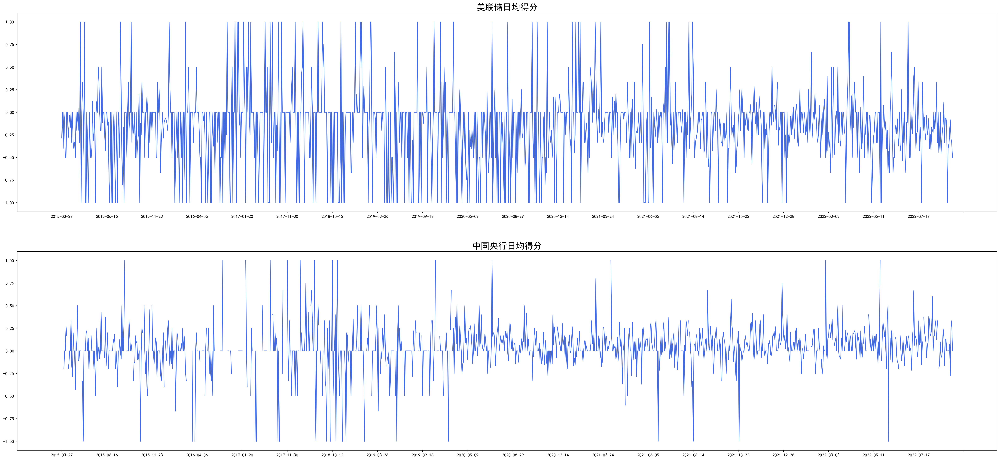

In [15]:
#央行情绪得分可视化（非标准化）
fig, axes = plt.subplots(2, 1, figsize=(40, 18), dpi=200)
axes_list = []

for i in range(axes.shape[0]):
    axes_list.append(axes[i])

#x_label = data_raw.index.tolist()
title_list = emo_score.columns.tolist()

i = 0
for ax in axes_list:
    ax.plot(emo_score.iloc[:, i], color="royalblue")
    ax.set_title(title_list[i], fontsize=20)
    tick_spacing = 63 
    ax.xaxis.set_major_locator(ticker.MultipleLocator(tick_spacing))
    i += 1
    
plt.savefig('央行情绪得分.png', dpi=200, bbox_inches='tight')
plt.show()

In [16]:
#数据合并
fed_score_aver.index = pd.to_datetime(fed_score_aver.index)
pbc_score_aver.index = pd.to_datetime(pbc_score_aver.index)

data5= data3.copy()
data5['美联储日均得分'] = fed_score_aver
data5['中国央行日均得分'] = pbc_score_aver
data6=data5[31:]#因为取均值只有20天，正好剔出了空值
#print(data6.isnull().sum())
data6 = data6.fillna(0)

In [17]:
#标准化并导出数据
data7 = pd.DataFrame()
data7.index = data6.index

for i in data6.columns:
    data7[i] = preprocessing.scale(data6[i])

data7 = data7.drop(columns = ['上证50ETF波动率指数{}天均值'.format(rolling_days)])
data7['上证50ETF波动率指数{}天均值'.format(rolling_days)] = data6['上证50ETF波动率指数{}天均值'.format(rolling_days)]

print(data7['美联储日均得分'].std())
print(data7['美联储日均得分'].mean())

data7.to_excel('data_all_std2.xlsx')
data6.to_excel('data_all2.xlsx')

1.0002692152424646
-1.380190065812264e-15


## 文本情绪分析(请勿跑）

### 数据翻译

In [17]:
#中国央行动态数据翻译
pbc_ch = pd.read_excel('pbc_ch.xlsx')
from google_trans_new import google_translator  
translator = google_translator()

pbc_trans = []
for i in pbc_ch['标题'].tolist():
    temp = translator.translate(i,lang_tgt='en')
    print(temp)
    pbc_trans.append(temp)

pd.DataFrame(pbc_trans).to_excel('pbc_trans.xlsx') 

ModuleNotFoundError: No module named 'google_trans_new'

In [39]:
#美联储动态数据翻译
fed_ch = pd.read_excel('fed_ch.xlsx')
from google_trans_new import google_translator  
translator = google_translator()

fed_trans = []
for i in fed_ch['标题'].tolist():
    temp = translator.translate(i,lang_tgt='en')
    print(temp)
    fed_trans.append(temp)

pd.DataFrame(fed_trans).to_excel('fed_trans.xlsx') 

ModuleNotFoundError: No module named 'google_trans_new'

### Finbert情绪分析

In [ ]:
from transformers import BertTokenizer, BertForSequenceClassification
from transformers import pipeline

In [ ]:
def max_i(a,b,c) -> int:
    if (a > b and a > c):
        return 0
    elif b > c:
        return 1
    else:
        return 2

In [ ]:
finbert = BertForSequenceClassification.from_pretrained('yiyanghkust/finbert-tone',num_labels=3)
tokenizer1 = BertTokenizer.from_pretrained('yiyanghkust/finbert-tone')
#tokenizer2 = BertTokenizer.from_pretrained('bert-base-chinese')
nlp1 = pipeline("sentiment-analysis", model=finbert, tokenizer=tokenizer1, return_all_scores=True)

In [ ]:
file1 = pd.read_excel("fed_trans_total.xlsx")
file2 = pd.read_excel("pbc_trans_total.xlsx")

In [ ]:
sentences1 = [item for item in file1["译文"]]
sentences2 = [item for item in file2["译文"]]
results1 = nlp1(sentences1)
results2 = nlp1(sentences2)

In [ ]:
file1['label'] = [
    results1[i][max_i(results1[i][0]['score'], results1[i][1]['score'],
                      results1[i][2]['score'])]['label']
    for i in range(len(results1))
]
file2['label'] = [
    results2[i][max_i(results2[i][0]['score'], results2[i][1]['score'],
                      results2[i][2]['score'])]['label']
    for i in range(len(results2))
]
file1['all_pos'] = results1
file2['all_pos'] = results2

In [ ]:
file1.to_excel("fed.xlsx")
file2.to_excel("pbc.xlsx")

## 描述性统计

In [18]:
#导入经过处理的数据(非预测变量已经经过标准化，对于每一个变量单独进行标准化）
'''
data_raw = pd.read_excel("data_all.xlsx",
                   parse_dates=["交易日期"],
                   index_col=[0])
data = pd.read_excel("data_all_std.xlsx",
                   parse_dates=["交易日期"],
                   index_col=[0])
df = data.copy()
'''

#使用去噪数据
data_raw = pd.read_excel("data_all2.xlsx",
                   parse_dates=["交易日期"],
                   index_col=[0])
data_raw = data_raw.iloc[:,21:]
data = pd.read_excel("data_all_std2.xlsx",
                   parse_dates=["交易日期"],
                   index_col=[0])
data = data.iloc[:,21:]
df = data.copy()

### 特征走势

In [19]:
fig, axes = plt.subplots(23, 1, figsize=(40, 200), dpi=200)
axes_list = []

for i in range(axes.shape[0]):
    axes_list.append(axes[i])

#x_label = data_raw.index.tolist()
title_list = data_raw.columns.tolist()

i = 0
for ax in axes_list:
    ax.plot(data_raw.iloc[:, i], color="royalblue")
    #ax.plot(data_raw.iloc[:, i], color="royalblue")
    ax.set_title(title_list[i], fontsize=20)
    i += 1

plt.savefig('特征趋势图.png', dpi=200, bbox_inches='tight')
plt.show()

### 特征分布

In [20]:
fig, axes = plt.subplots(23, 1, figsize=(40, 240), dpi=200)
axes_list = []

for i in range(axes.shape[0]):
    axes_list.append(axes[i])

#x_label = data_raw.index.tolist()
title_list = data_raw.columns.tolist()
i = 0
for ax in axes_list:
    ax = sns.distplot(data_raw.iloc[:, i].tolist(),
                      ax=ax,
                      hist_kws={
                          "color": "green",
                          'linewidth': 3
                      },
                      kde_kws={
                          "color": "deeppink",
                          'linewidth': 3
                      })
    ax.set_title(title_list[i], fontsize=20)
    i += 1
plt.savefig('特征分布图.png', dpi=200, bbox_inches='tight')
plt.show()

### 特征相关性

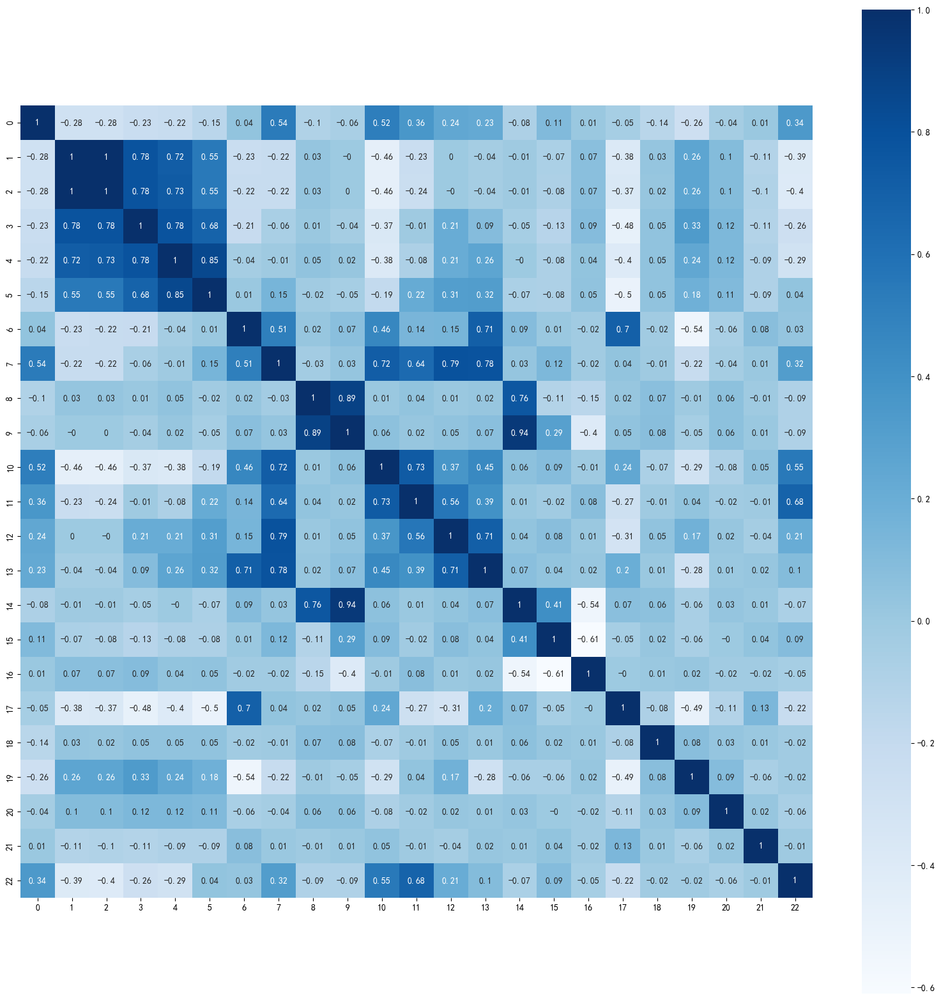

In [21]:
#绘制特征相关系数矩阵热力图（这里应该使用全部标准化后的数据？）
corr = np.around(np.corrcoef(df.T),decimals=2)
plt.subplots(figsize=(20,20))
sns.heatmap(corr, annot=True, vmax=1, square=True, cmap="Blues")
plt.savefig('特征相关性图.png', dpi=200, bbox_inches='tight')
plt.show()

# 数据预处理

## 特征提取

还需要主成分分析可视化，或者尝试一些其他特征提取方式

In [22]:
#PCA降维
varibles = df.iloc[:,1:]
pca = decomposition.PCA(n_components=13)
pca_model = pca.fit(varibles)
variables_pca = pca_model.fit_transform(varibles)
main_component = pd.DataFrame(variables_pca.T).T
main_component.columns = ['主成分1','主成分2','主成分3','主成分4','主成分5','主成分6','主成分7','主成分8','主成分9','主成分10','主成分11','主成分12','主成分13',]
main_component.index = df.index
main_component.head(5)

,主成分1,主成分2,主成分3,主成分4,主成分5,主成分6,主成分7,主成分8,主成分9,主成分10,主成分11,主成分12,主成分13
交易日期,,,,,,,,,,,,,
2015-03-27,5.176974,-4.198961,3.080899,-0.703087,-0.238118,0.299821,0.801202,-0.044388,1.170253,-2.738631,1.008190,1.202011,0.372356
2015-03-30,4.921724,-4.341160,3.178268,-0.369542,1.128391,0.467212,1.589771,-0.199717,1.019242,-2.653997,0.973132,1.080117,0.578663
2015-03-31,4.834318,-4.495966,3.215453,-0.336030,0.801145,0.527674,0.927916,0.481777,0.137023,-2.613878,1.007201,1.258472,0.403932
2015-04-01,4.808059,-4.254706,3.725264,-1.110604,1.677150,0.416579,0.650958,0.540750,0.918066,-2.404656,0.771098,0.974501,0.394621
2015-04-02,5.432080,-3.887619,3.908420,-1.594796,0.043037,0.170814,1.316355,-0.154196,1.668147,-2.253297,0.703292,1.164143,0.324226


## 标准化

In [23]:
#对主成分结果进行标准化
for i in main_component.columns:
    main_component[i] = preprocessing.scale(main_component[i])

In [24]:
#对预测变量进行标准化（初始其它特征已经标准化）
#target = np.array(df['上证50ETF波动率指数'])
target = np.array(df['上证50ETF波动率指数{}天均值'.format(rolling_days)])
target = target.reshape(-1,1)
std = StandardScaler()
std_target = std.fit_transform(target)
std_target_ser = pd.Series(std_target.flatten())
std_target_ser.index = df.index
#df["上证50ETF波动率指数"]=std_target_ser
#main_component["上证50ETF波动率指数"] = std_target_ser #可以后续改用主成分进行预测
df['上证50ETF波动率指数{}天均值'.format(rolling_days)]=std_target_ser
main_component['上证50ETF波动率指数{}天均值'.format(rolling_days)] = std_target_ser

## 分割数据

In [25]:
#数据切片
test_split = round(len(df) * 0.03)
#全数据
df_for_training = df[:-test_split]
df_for_testing = df[-test_split:]
df_for_training_arr = np.array(df_for_training)
df_for_testing_arr = np.array(df_for_testing)
#主成分数据
mc_training = main_component[:-test_split]
mc_testing = main_component[-test_split:]
mc_training_arr = np.array(mc_training)
mc_testing_arr = np.array(mc_testing)

In [26]:
#测试集和训练集构建函数
def createXY(dataset, n_past):
    dataX = []
    dataY = []
    for i in range(n_past, len(dataset)):
        dataX.append(dataset[i - n_past:i, 0:dataset.shape[1]])
        dataY.append(dataset[i, 0]) #CVIX
    return np.array(dataX), np.array(dataY)

n_past = 30
#全数据
trainX, trainY = createXY(df_for_training_arr, n_past)
testX, testY = createXY(df_for_testing_arr, n_past)
#主成分数据
trainX_mc,trainY_mc = createXY(mc_training_arr, n_past)
testX_mc,testY_mc = createXY(mc_testing_arr, n_past)

# 模型构建

## 神经网络框架

这里模型还需要进一步优化

In [27]:
#模型构建函数
def build_model(optimizer):
    grid_model = Sequential()
    grid_model.add(LSTM(50, return_sequences=True, input_shape=(n_past, 23)))
    grid_model.add(LSTM(50))
    grid_model.add(Dropout(0.2))
    grid_model.add(Dense(1))

    grid_model.compile(loss='mse', optimizer=optimizer)
    return grid_model

In [28]:
#模型构建函数(主成分数据)
def build_model_mc(optimizer):
    grid_model = Sequential()
    grid_model.add(LSTM(50, return_sequences=True, input_shape=(n_past, 14)))
    grid_model.add(LSTM(50))
    grid_model.add(Dropout(0.2))
    grid_model.add(Dense(1))

    grid_model.compile(loss='mse', optimizer=optimizer)
    return grid_model

## 调节参数

需进一步细致调参，绘制调参CV图（根据评估指标）；看看是否还有其他调参方式；GPU训练；学习率；还应兼顾训练时间

### 未降维情况调参

In [30]:
#使用GrdiSearchCV自动调参(全数据)
grid_model = KerasRegressor(build_fn=build_model,
                            verbose=1,
                            validation_data=(testX, testY))

parameters = {
    'batch_size': [5,10,15,20,30],
    'epochs': [5,7,9,11,13,15],
    'optimizer': ['adam', 'Adadelta']
}

grid_search = GridSearchCV(estimator=grid_model, param_grid=parameters, cv=2)

grid_search = grid_search.fit(trainX, trainY)

#输出初步调参最佳参数
print(grid_search.best_params_)
#存储模型
my_model = grid_search.best_estimator_.model

Epoch 1/5
178/178 [==============================] - 7s 19ms/step - loss: 0.1197 - val_loss: 0.0194
Epoch 2/5
178/178 [==============================] - 2s 14ms/step - loss: 0.0335 - val_loss: 0.0523
Epoch 3/5
178/178 [==============================] - 3s 14ms/step - loss: 0.0272 - val_loss: 0.0214
Epoch 4/5
178/178 [==============================] - 3s 14ms/step - loss: 0.0256 - val_loss: 0.0163
Epoch 5/5
178/178 [==============================] - 1s 4ms/step - loss: 0.2282
Epoch 1/5
178/178 [==============================] - 7s 19ms/step - loss: 0.0729 - val_loss: 0.9804
Epoch 2/5
178/178 [==============================] - 3s 14ms/step - loss: 0.0260 - val_loss: 0.5231
Epoch 3/5
178/178 [==============================] - 3s 14ms/step - loss: 0.0196 - val_loss: 0.4598
Epoch 4/5
178/178 [==============================] - 3s 14ms/step - loss: 0.0159 - val_loss: 0.4276
Epoch 5/5
178/178 [==============================] - 1s 4ms/step - loss: 0.1813
Epoch 1/5
178/178 [=====================

178/178 [==============================] - 1s 4ms/step - loss: 0.3383
Epoch 1/9
178/178 [==============================] - 7s 19ms/step - loss: 0.6083 - val_loss: 3.4494
Epoch 2/9
178/178 [==============================] - 3s 15ms/step - loss: 0.5921 - val_loss: 3.4210
Epoch 3/9
178/178 [==============================] - 3s 15ms/step - loss: 0.5941 - val_loss: 3.3932
Epoch 4/9
178/178 [==============================] - 3s 15ms/step - loss: 0.5586 - val_loss: 3.3671
Epoch 5/9
178/178 [==============================] - 3s 15ms/step - loss: 0.5487 - val_loss: 3.3416
Epoch 6/9
178/178 [==============================] - 3s 15ms/step - loss: 0.5369 - val_loss: 3.3161
Epoch 7/9
178/178 [==============================] - 3s 15ms/step - loss: 0.5296 - val_loss: 3.2920
Epoch 8/9
178/178 [==============================] - 3s 15ms/step - loss: 0.5186 - val_loss: 3.2678
Epoch 9/9
178/178 [==============================] - 1s 4ms/step - loss: 1.4470
Epoch 1/11
178/178 [==============================

Epoch 4/15
178/178 [==============================] - 3s 15ms/step - loss: 0.5677 - val_loss: 1.9399
Epoch 5/15
178/178 [==============================] - 3s 15ms/step - loss: 0.5623 - val_loss: 1.9324
Epoch 6/15
178/178 [==============================] - 3s 15ms/step - loss: 0.5501 - val_loss: 1.9256
Epoch 7/15
178/178 [==============================] - 3s 15ms/step - loss: 0.5417 - val_loss: 1.9191
Epoch 8/15
178/178 [==============================] - 3s 15ms/step - loss: 0.5347 - val_loss: 1.9124
Epoch 9/15
178/178 [==============================] - 3s 15ms/step - loss: 0.5234 - val_loss: 1.9068
Epoch 10/15
178/178 [==============================] - 3s 15ms/step - loss: 0.5131 - val_loss: 1.9019
Epoch 11/15
178/178 [==============================] - 3s 15ms/step - loss: 0.5043 - val_loss: 1.8971
Epoch 12/15
178/178 [==============================] - 3s 15ms/step - loss: 0.5040 - val_loss: 1.8919
Epoch 13/15
178/178 [==============================] - 3s 15ms/step - loss: 0.4874 - val

89/89 [==============================] - 6s 26ms/step - loss: 0.0857 - val_loss: 0.7198
Epoch 2/13
89/89 [==============================] - 1s 16ms/step - loss: 0.0224 - val_loss: 0.4655
Epoch 3/13
89/89 [==============================] - 2s 17ms/step - loss: 0.0170 - val_loss: 0.3584
Epoch 4/13
89/89 [==============================] - 1s 16ms/step - loss: 0.0145 - val_loss: 0.3104
Epoch 5/13
89/89 [==============================] - 1s 16ms/step - loss: 0.0151 - val_loss: 0.3532
Epoch 6/13
89/89 [==============================] - 1s 16ms/step - loss: 0.0136 - val_loss: 0.3381
Epoch 7/13
89/89 [==============================] - 1s 16ms/step - loss: 0.0097 - val_loss: 0.4575
Epoch 8/13
89/89 [==============================] - 1s 16ms/step - loss: 0.0103 - val_loss: 0.2462
Epoch 9/13
89/89 [==============================] - 1s 16ms/step - loss: 0.0096 - val_loss: 0.2473
Epoch 10/13
89/89 [==============================] - 1s 16ms/step - loss: 0.0089 - val_loss: 0.2899
Epoch 11/13
89/89 [=

60/60 [==============================] - 0s 6ms/step - loss: 0.1640
Epoch 1/9
60/60 [==============================] - 5s 31ms/step - loss: 0.0883 - val_loss: 0.9744
Epoch 2/9
60/60 [==============================] - 1s 18ms/step - loss: 0.0262 - val_loss: 0.6520
Epoch 3/9
60/60 [==============================] - 1s 18ms/step - loss: 0.0185 - val_loss: 0.5541
Epoch 4/9
60/60 [==============================] - 1s 18ms/step - loss: 0.0149 - val_loss: 0.4800
Epoch 5/9
60/60 [==============================] - 1s 18ms/step - loss: 0.0172 - val_loss: 0.5548
Epoch 6/9
60/60 [==============================] - 1s 18ms/step - loss: 0.0135 - val_loss: 0.3894
Epoch 7/9
60/60 [==============================] - 1s 18ms/step - loss: 0.0120 - val_loss: 0.3304
Epoch 8/9
60/60 [==============================] - 1s 18ms/step - loss: 0.0117 - val_loss: 0.3824
Epoch 9/9
60/60 [==============================] - 0s 6ms/step - loss: 0.3049
Epoch 1/9
60/60 [==============================] - 5s 33ms/step - loss

60/60 [==============================] - 1s 18ms/step - loss: 1.2317 - val_loss: 2.1477
Epoch 3/15
60/60 [==============================] - 1s 18ms/step - loss: 1.2259 - val_loss: 2.1266
Epoch 4/15
60/60 [==============================] - 1s 18ms/step - loss: 1.2225 - val_loss: 2.1112
Epoch 5/15
60/60 [==============================] - 1s 18ms/step - loss: 1.2090 - val_loss: 2.0938
Epoch 6/15
60/60 [==============================] - 1s 19ms/step - loss: 1.2022 - val_loss: 2.0783
Epoch 7/15
60/60 [==============================] - 1s 18ms/step - loss: 1.1803 - val_loss: 2.0616
Epoch 8/15
60/60 [==============================] - 1s 19ms/step - loss: 1.1717 - val_loss: 2.0450
Epoch 9/15
60/60 [==============================] - 1s 19ms/step - loss: 1.1623 - val_loss: 2.0284
Epoch 10/15
60/60 [==============================] - 1s 19ms/step - loss: 1.1449 - val_loss: 2.0100
Epoch 11/15
60/60 [==============================] - 1s 19ms/step - loss: 1.1277 - val_loss: 1.9917
Epoch 12/15
60/60 [

45/45 [==============================] - 1s 19ms/step - loss: 0.5323 - val_loss: 2.8976
Epoch 10/11
45/45 [==============================] - 1s 19ms/step - loss: 0.5145 - val_loss: 2.8813
Epoch 11/11
45/45 [==============================] - 0s 6ms/step - loss: 1.0611
Epoch 1/13
45/45 [==============================] - 5s 37ms/step - loss: 0.2265 - val_loss: 0.0131
Epoch 2/13
45/45 [==============================] - 1s 19ms/step - loss: 0.0365 - val_loss: 0.0782
Epoch 3/13
45/45 [==============================] - 1s 19ms/step - loss: 0.0282 - val_loss: 0.0082
Epoch 4/13
45/45 [==============================] - 1s 19ms/step - loss: 0.0243 - val_loss: 0.0519
Epoch 5/13
45/45 [==============================] - 1s 19ms/step - loss: 0.0214 - val_loss: 0.0098
Epoch 6/13
45/45 [==============================] - 1s 19ms/step - loss: 0.0227 - val_loss: 0.0456
Epoch 7/13
45/45 [==============================] - 1s 19ms/step - loss: 0.0162 - val_loss: 0.0640
Epoch 8/13
45/45 [=====================

Epoch 7/7
30/30 [==============================] - 0s 8ms/step - loss: 0.5333
Epoch 1/7
30/30 [==============================] - 5s 59ms/step - loss: 0.4978 - val_loss: 2.7744
Epoch 2/7
30/30 [==============================] - 1s 23ms/step - loss: 0.4913 - val_loss: 2.7648
Epoch 3/7
30/30 [==============================] - 1s 23ms/step - loss: 0.4918 - val_loss: 2.7552
Epoch 4/7
30/30 [==============================] - 1s 23ms/step - loss: 0.4839 - val_loss: 2.7456
Epoch 5/7
30/30 [==============================] - 1s 23ms/step - loss: 0.4821 - val_loss: 2.7359
Epoch 6/7
30/30 [==============================] - 1s 23ms/step - loss: 0.4743 - val_loss: 2.7260
Epoch 7/7
30/30 [==============================] - 0s 8ms/step - loss: 1.2145
Epoch 1/9
30/30 [==============================] - 5s 50ms/step - loss: 0.4716 - val_loss: 0.0106
Epoch 2/9
30/30 [==============================] - 1s 22ms/step - loss: 0.0545 - val_loss: 0.0093
Epoch 3/9
30/30 [==============================] - 1s 22ms/s

Epoch 1/11
30/30 [==============================] - 5s 50ms/step - loss: 0.8654 - val_loss: 4.5557
Epoch 2/11
30/30 [==============================] - 1s 23ms/step - loss: 0.8447 - val_loss: 4.5400
Epoch 3/11
30/30 [==============================] - 1s 23ms/step - loss: 0.8549 - val_loss: 4.5244
Epoch 4/11
30/30 [==============================] - 1s 24ms/step - loss: 0.8452 - val_loss: 4.5084
Epoch 5/11
30/30 [==============================] - 1s 23ms/step - loss: 0.8342 - val_loss: 4.4922
Epoch 6/11
30/30 [==============================] - 1s 24ms/step - loss: 0.8169 - val_loss: 4.4761
Epoch 7/11
30/30 [==============================] - 1s 24ms/step - loss: 0.8150 - val_loss: 4.4597
Epoch 8/11
30/30 [==============================] - 1s 23ms/step - loss: 0.8165 - val_loss: 4.4436
Epoch 9/11
30/30 [==============================] - 1s 31ms/step - loss: 0.8105 - val_loss: 4.4273
Epoch 10/11
30/30 [==============================] - 1s 23ms/step - loss: 0.7994 - val_loss: 4.4108
Epoch 11/

### 进一步细致调参

### 降维情况调参

In [29]:
#使用GrdiSearchCV自动调参(主成分数据)
grid_model = KerasRegressor(build_fn=build_model_mc,
                            verbose=1,
                            validation_data=(testX_mc, testY_mc))

parameters = {
    'batch_size': [3,5,7],
    'epochs': [7,9,11],
    'optimizer': ['adam', 'Adadelta']
}

grid_search = GridSearchCV(estimator=grid_model, param_grid=parameters, cv=2)

grid_search = grid_search.fit(trainX_mc, trainY_mc)

#输出初步调参最佳参数
print(grid_search.best_params_)
#存储模型
my_model_mc = grid_search.best_estimator_.model

Epoch 1/7
296/296 [==============================] - 8s 17ms/step - loss: 0.0642 - val_loss: 0.0413
Epoch 2/7
296/296 [==============================] - 4s 14ms/step - loss: 0.0261 - val_loss: 0.0226
Epoch 3/7
296/296 [==============================] - 4s 14ms/step - loss: 0.0158 - val_loss: 0.0251
Epoch 4/7
296/296 [==============================] - 4s 14ms/step - loss: 0.0138 - val_loss: 0.0433
Epoch 5/7
296/296 [==============================] - 4s 14ms/step - loss: 0.0120 - val_loss: 0.0397
Epoch 6/7
296/296 [==============================] - 4s 14ms/step - loss: 0.0102 - val_loss: 0.0440
Epoch 7/7
296/296 [==============================] - 1s 4ms/step - loss: 0.3579
Epoch 1/7
296/296 [==============================] - 9s 18ms/step - loss: 0.1651 - val_loss: 0.4340
Epoch 2/7
296/296 [==============================] - 4s 15ms/step - loss: 0.0531 - val_loss: 0.7702
Epoch 3/7
296/296 [==============================] - 4s 14ms/step - loss: 0.0538 - val_loss: 0.5998
Epoch 4/7
296/296 [=

296/296 [==============================] - 9s 18ms/step - loss: 0.1646 - val_loss: 0.2305
Epoch 2/11
296/296 [==============================] - 4s 15ms/step - loss: 0.0566 - val_loss: 0.3230
Epoch 3/11
296/296 [==============================] - 4s 15ms/step - loss: 0.0451 - val_loss: 0.3906
Epoch 4/11
296/296 [==============================] - 4s 15ms/step - loss: 0.0427 - val_loss: 0.2622
Epoch 5/11
296/296 [==============================] - 4s 15ms/step - loss: 0.0371 - val_loss: 0.3521
Epoch 6/11
296/296 [==============================] - 4s 15ms/step - loss: 0.0327 - val_loss: 0.3565
Epoch 7/11
296/296 [==============================] - 4s 15ms/step - loss: 0.0295 - val_loss: 0.2650
Epoch 8/11
296/296 [==============================] - 4s 15ms/step - loss: 0.0311 - val_loss: 0.3315
Epoch 9/11
296/296 [==============================] - 4s 15ms/step - loss: 0.0259 - val_loss: 0.3167
Epoch 10/11
296/296 [==============================] - 4s 15ms/step - loss: 0.0291 - val_loss: 0.4565


178/178 [==============================] - 3s 15ms/step - loss: 0.0295 - val_loss: 0.5624
Epoch 8/9
178/178 [==============================] - 3s 15ms/step - loss: 0.0289 - val_loss: 0.6369
Epoch 9/9
178/178 [==============================] - 1s 4ms/step - loss: 0.1249
Epoch 1/9
178/178 [==============================] - 7s 19ms/step - loss: 0.2688 - val_loss: 0.0360
Epoch 2/9
178/178 [==============================] - 3s 15ms/step - loss: 0.2558 - val_loss: 0.0339
Epoch 3/9
178/178 [==============================] - 3s 15ms/step - loss: 0.2521 - val_loss: 0.0321
Epoch 4/9
178/178 [==============================] - 3s 15ms/step - loss: 0.2477 - val_loss: 0.0305
Epoch 5/9
178/178 [==============================] - 3s 15ms/step - loss: 0.2464 - val_loss: 0.0290
Epoch 6/9
178/178 [==============================] - 3s 15ms/step - loss: 0.2456 - val_loss: 0.0277
Epoch 7/9
178/178 [==============================] - 3s 15ms/step - loss: 0.2393 - val_loss: 0.0264
Epoch 8/9
178/178 [===========

Epoch 5/7
127/127 [==============================] - 2s 15ms/step - loss: 0.0319 - val_loss: 0.4595
Epoch 6/7
127/127 [==============================] - 2s 16ms/step - loss: 0.0361 - val_loss: 0.6685
Epoch 7/7
127/127 [==============================] - 1s 4ms/step - loss: 0.1638
Epoch 1/7
127/127 [==============================] - 6s 22ms/step - loss: 0.3331 - val_loss: 0.0382
Epoch 2/7
127/127 [==============================] - 2s 15ms/step - loss: 0.3317 - val_loss: 0.0379
Epoch 3/7
127/127 [==============================] - 2s 15ms/step - loss: 0.3299 - val_loss: 0.0375
Epoch 4/7
127/127 [==============================] - 2s 16ms/step - loss: 0.3245 - val_loss: 0.0373
Epoch 5/7
127/127 [==============================] - 2s 15ms/step - loss: 0.3254 - val_loss: 0.0370
Epoch 6/7
127/127 [==============================] - 2s 16ms/step - loss: 0.3184 - val_loss: 0.0368
Epoch 7/7
127/127 [==============================] - 1s 4ms/step - loss: 1.9057
Epoch 1/7
127/127 [=====================

127/127 [==============================] - 6s 22ms/step - loss: 0.3655 - val_loss: 0.1526
Epoch 2/11
127/127 [==============================] - 2s 15ms/step - loss: 0.3608 - val_loss: 0.1463
Epoch 3/11
127/127 [==============================] - 2s 15ms/step - loss: 0.3584 - val_loss: 0.1401
Epoch 4/11
127/127 [==============================] - 2s 16ms/step - loss: 0.3466 - val_loss: 0.1344
Epoch 5/11
127/127 [==============================] - 2s 16ms/step - loss: 0.3451 - val_loss: 0.1289
Epoch 6/11
127/127 [==============================] - 2s 16ms/step - loss: 0.3418 - val_loss: 0.1239
Epoch 7/11
127/127 [==============================] - 2s 16ms/step - loss: 0.3474 - val_loss: 0.1190
Epoch 8/11
127/127 [==============================] - 2s 16ms/step - loss: 0.3383 - val_loss: 0.1142
Epoch 9/11
127/127 [==============================] - 2s 16ms/step - loss: 0.3308 - val_loss: 0.1096
Epoch 10/11
127/127 [==============================] - 2s 16ms/step - loss: 0.3284 - val_loss: 0.1051


## 模型优化

# 模型评估

需要计算多个评估指标，并对没有情感数据和有情感数据，基础的和优化后的模型进行对比（这里还有很多需要对比）

## 未降维模型结果

In [29]:
#根据最优调参结果进行训练（全数据）
lstm_best = KerasRegressor(build_fn=build_model,
                            verbose=1,
                            validation_data=(testX, testY),
                          batch_size = 5,
                          epochs = 9,
                          optimizer = 'adam')
lstm_best = lstm_best.fit(trainX,trainY)
lstm_best = lstm_best.model

Epoch 1/9
355/355 [==============================] - 8s 14ms/step - loss: 0.0738 - val_loss: 0.0099
Epoch 2/9
355/355 [==============================] - 4s 12ms/step - loss: 0.0242 - val_loss: 0.0293
Epoch 3/9
355/355 [==============================] - 4s 13ms/step - loss: 0.0201 - val_loss: 0.0610
Epoch 4/9
355/355 [==============================] - 5s 13ms/step - loss: 0.0172 - val_loss: 0.0226
Epoch 5/9
355/355 [==============================] - 5s 13ms/step - loss: 0.0145 - val_loss: 0.0136
Epoch 6/9
355/355 [==============================] - 5s 13ms/step - loss: 0.0140 - val_loss: 0.0492
Epoch 7/9
355/355 [==============================] - 5s 13ms/step - loss: 0.0145 - val_loss: 0.0091
Epoch 8/9
355/355 [==============================] - 5s 13ms/step - loss: 0.0133 - val_loss: 0.0058
Epoch 9/9
355/355 [==============================] - 5s 14ms/step - loss: 0.0132 - val_loss: 0.0118


In [30]:
#模型在测试集预测结果(全数据)
pred_test = lstm_best.predict(testX)
print("测试集预测结果:\n",pred_test.reshape(1,26))
print("测试集实际结果:\n",testY)
#将测试集预测结果反标准化
pred_test_origin = std.inverse_transform(pred_test.reshape(-1,1))
#将测试集真实结果反标准化
testY_origin = std.inverse_transform(testY.reshape(-1,1))
#反归一化结果
print("测试集预测反标准化结果:\n",pred_test_origin.flatten())
print("真实集预测反标准化结果:\n",testY_origin.flatten())
#数据格式整理
test_result = pd.DataFrame()
test_result.index = df[-len(pred_test_origin):].index
test_result['测试集实际结果'] = testY_origin
test_result['测试集预测结果'] = pred_test_origin

1/1 [==============================] - 1s 587ms/step
测试集预测结果:
 [[1.618205  1.6014067 1.5726886 1.5456161 1.5297749 1.5386679 1.5611448
  1.5743048 1.5817271 1.5865455 1.5610772 1.5341681 1.5057724 1.4988656
  1.4769876 1.4530295 1.4452009 1.4290477 1.4202236 1.4298047 1.4551761
  1.4627169 1.4871606 1.5180073 1.5228685 1.5206116]]
测试集实际结果:
 [1.64338372 1.66016608 1.67343889 1.65349442 1.63678256 1.63017636
 1.62254299 1.61343933 1.63727601 1.66170182 1.66418418 1.63706453
 1.63079066 1.60994992 1.59019679 1.57846979 1.58816257 1.59473352
 1.60344443 1.61919457 1.60069017 1.58263391 1.55424036 1.51199998
 1.45328942 1.43707101]
测试集预测反标准化结果:
 [34.125576 33.997723 33.779144 33.573097 33.452526 33.52021  33.691284
 33.791447 33.84794  33.884613 33.690773 33.485966 33.26984  33.217274
 33.05076  32.868412 32.808826 32.685883 32.618725 32.691647 32.88475
 32.942142 33.128185 33.36296  33.399963 33.382786]
真实集预测反标准化结果:
 [34.31721274 34.44494459 34.54596503 34.3941661  34.26697078 34.2166905
 

In [31]:
#模型在训练集预测（全数据）
pred_train = lstm_best.predict(trainX)
#将训练集预测结果反归一化
pred_train_origin = std.inverse_transform(pred_train.reshape(-1,1))
#将训练集真实结果反归一化
trainY_origin = std.inverse_transform(trainY.reshape(-1,1))
#数据格式整理
train_result = pd.DataFrame()
train_result.index = df[n_past:-test_split].index #need to make sure that this is right
train_result['训练集实际结果'] = trainY_origin
train_result['训练集预测结果'] = pred_train_origin

56/56 [==============================] - 0s 5ms/step


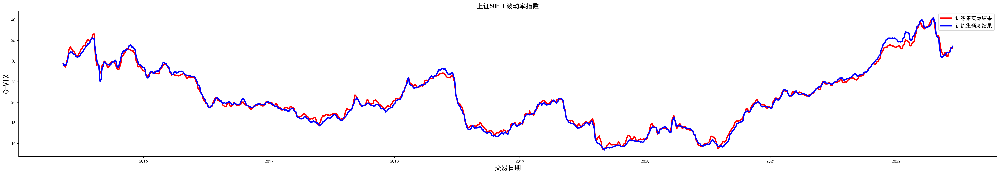

In [32]:
#训练集实际和预测结果对比（全数据）
fig,ax = plt.subplots(1,1,figsize=(40,6),dpi=200)
plt.plot(train_result['训练集实际结果'], color='red', label='训练集实际结果',linewidth=3.0)
plt.plot(train_result['训练集预测结果'], color='blue', label='训练集预测结果',linewidth=3.0)
plt.title('上证50ETF波动率指数',fontsize=15)
plt.xlabel('交易日期',fontsize=15) #这里填上日期数据
plt.ylabel('C-VIX',fontsize=18)
#plt.xticks(train_result.index,rotation=90)
plt.legend(prop={'size': 12})
plt.savefig('全数据训练集预测结果.png', dpi=200, bbox_inches='tight')
plt.show()

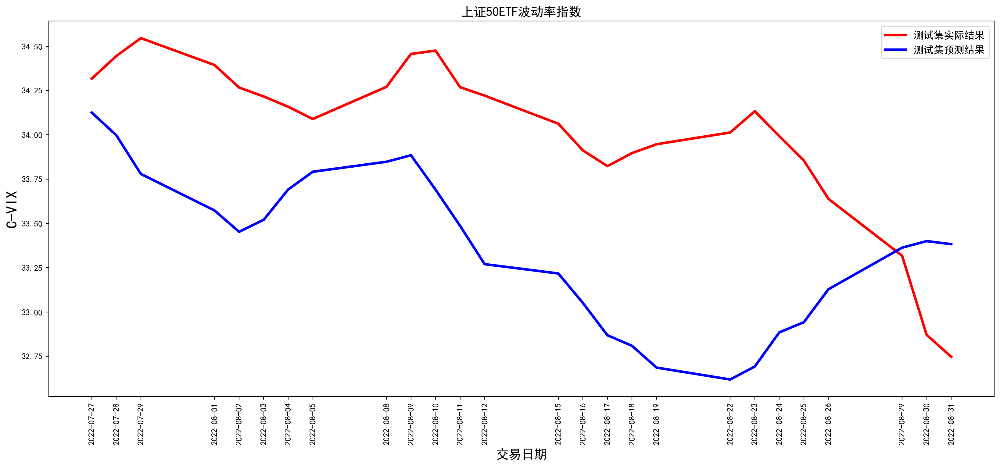

In [33]:
#测试集实际和预测结果对比（全数据）
fig,ax = plt.subplots(1,1,figsize=(20,8),dpi=200)
plt.plot(test_result['测试集实际结果'], color='red', label='测试集实际结果',linewidth=3.0)
plt.plot(test_result['测试集预测结果'], color='blue', label='测试集预测结果',linewidth=3.0)
plt.title('上证50ETF波动率指数',fontsize=15)
plt.xlabel('交易日期',fontsize=15) #这里填上日期数据
plt.ylabel('C-VIX',fontsize=18)
plt.xticks(test_result.index,rotation=90)
plt.legend(prop={'size': 12})
plt.savefig('全数据测试集预测结果.png', dpi=200, bbox_inches='tight')
plt.show()

## 降维模型结果

In [30]:
#根据最优调参结果进行训练（主成分数据）
lstm_best_mc = KerasRegressor(build_fn=build_model_mc,
                            verbose=1,
                            validation_data=(testX_mc, testY_mc),
                          batch_size = 3,
                          epochs = 11,
                          optimizer = 'adam')
lstm_best_mc = lstm_best_mc.fit(trainX_mc,trainY_mc)
lstm_best_mc = lstm_best_mc.model

Epoch 1/11
591/591 [==============================] - 12s 15ms/step - loss: 0.1074 - val_loss: 0.0190
Epoch 2/11
591/591 [==============================] - 8s 14ms/step - loss: 0.0443 - val_loss: 0.0163
Epoch 3/11
591/591 [==============================] - 8s 14ms/step - loss: 0.0274 - val_loss: 0.0171
Epoch 4/11
591/591 [==============================] - 8s 14ms/step - loss: 0.0227 - val_loss: 0.0090
Epoch 5/11
591/591 [==============================] - 9s 14ms/step - loss: 0.0219 - val_loss: 0.0071
Epoch 6/11
591/591 [==============================] - 9s 15ms/step - loss: 0.0217 - val_loss: 0.0082
Epoch 7/11
591/591 [==============================] - 9s 15ms/step - loss: 0.0198 - val_loss: 0.0061
Epoch 8/11
591/591 [==============================] - 9s 15ms/step - loss: 0.0179 - val_loss: 0.0069
Epoch 9/11
591/591 [==============================] - 9s 15ms/step - loss: 0.0167 - val_loss: 0.0059
Epoch 10/11
591/591 [==============================] - 9s 15ms/step - loss: 0.0152 - val_l

In [32]:
#模型在训练集预测（主成分数据）
pred_train_mc = lstm_best_mc.predict(trainX_mc)
#将训练集预测结果反标准化
pred_train_origin_mc = std.inverse_transform(pred_train_mc.reshape(-1,1))
#将训练集真实结果反标准化
trainY_origin_mc = std.inverse_transform(trainY_mc.reshape(-1,1))
#数据格式整理
train_result_mc = pd.DataFrame()
train_result_mc.index = main_component[n_past:-test_split].index #need to make sure that this is right
train_result_mc['训练集实际结果'] = trainY_origin_mc
train_result_mc['训练集预测结果'] = pred_train_origin_mc

56/56 [==============================] - 0s 8ms/step


In [33]:
#模型在测试集预测结果(主成分数据)
pred_test_mc = lstm_best_mc.predict(testX_mc)
print("测试集预测结果:\n",pred_test_mc.reshape(1,26))
print("测试集实际结果:\n",testY_mc)
#将测试集预测结果反标准化
pred_test_origin_mc = std.inverse_transform(pred_test_mc.reshape(-1,1))
#将测试集真实结果反标准化
testY_origin_mc = std.inverse_transform(testY_mc.reshape(-1,1))
#反标准化结果
print("测试集预测反标准化结果:\n",pred_test_origin_mc.flatten())
print("真实集预测反标准化结果:\n",testY_origin_mc.flatten())
#数据格式整理
test_result_mc = pd.DataFrame()
test_result_mc.index = df[-len(pred_test_origin_mc):].index
test_result_mc['测试集实际结果'] = testY_origin_mc
test_result_mc['测试集预测结果'] = pred_test_origin_mc

1/1 [==============================] - 0s 21ms/step
测试集预测结果:
 [[-0.23291253 -0.24464796 -0.24994327 -0.24440752 -0.22678159 -0.18372712
  -0.1143361  -0.07974564 -0.08709945 -0.13224275 -0.20169768 -0.25704873
  -0.27273428 -0.27146077 -0.29282755 -0.29572737 -0.26465958 -0.30316663
  -0.3282768  -0.34580034 -0.37772924 -0.4189279  -0.41143167 -0.43014902
  -0.4605583  -0.47288114]]
测试集实际结果:
 [-0.20903334 -0.23105958 -0.21089175 -0.19656707 -0.06719435  0.01024857
  0.04213574  0.01007388 -0.02427421 -0.15219919 -0.23326704 -0.25860758
 -0.26784919 -0.26932263 -0.27745994 -0.30085861 -0.31081673 -0.32272158
 -0.35425332 -0.38790447 -0.38325291 -0.41823474 -0.4595075  -0.47009274
 -0.480998   -0.51852587]
测试集预测反标准化结果:
 [20.036573 19.947254 19.90695  19.949083 20.083237 20.410927 20.939068
 21.20234  21.146368 20.802778 20.27415  19.85287  19.733486 19.74318
 19.580555 19.558485 19.794943 19.501863 19.310747 19.177376 18.934362
 18.620796 18.677849 18.53539  18.303944 18.210154]
真实集预测反标准

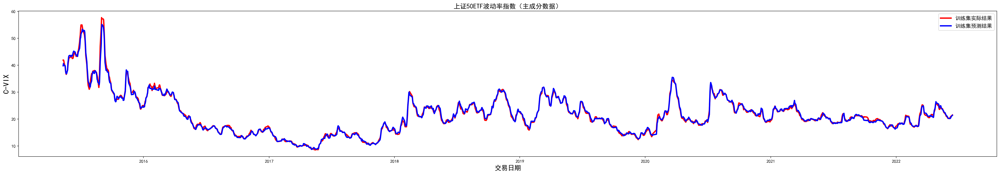

In [34]:
#训练集实际和预测结果对比（主成分数据）
fig,ax = plt.subplots(1,1,figsize=(40,6),dpi=200)
plt.plot(train_result_mc['训练集实际结果'], color='red', label='训练集实际结果',linewidth=3.0)
plt.plot(train_result_mc['训练集预测结果'], color='blue', label='训练集预测结果',linewidth=3.0)
plt.title('上证50ETF波动率指数（主成分数据）',fontsize=15)
plt.xlabel('交易日期',fontsize=15) #这里填上日期数据
plt.ylabel('C-VIX',fontsize=18)
#plt.xticks(train_result.index,rotation=90)
plt.legend(prop={'size': 12})
plt.savefig('主成分数据训练集预测结果.png', dpi=200, bbox_inches='tight')
plt.show()

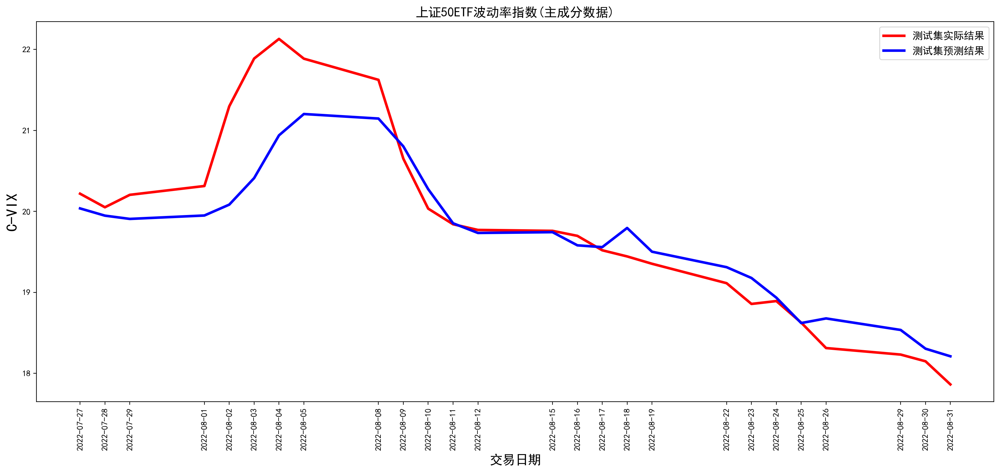

In [36]:
#测试集实际和预测结果对比（主成分数据）
fig,ax = plt.subplots(1,1,figsize=(20,8),dpi=200)
plt.plot(test_result_mc['测试集实际结果'], color='red', label='测试集实际结果',linewidth=3.0)
plt.plot(test_result_mc['测试集预测结果'], color='blue', label='测试集预测结果',linewidth=3.0)
plt.title('上证50ETF波动率指数(主成分数据)',fontsize=15)
plt.xlabel('交易日期',fontsize=15) #这里填上日期数据
plt.ylabel('C-VIX',fontsize=18)
plt.xticks(test_result_mc.index,rotation=90)
plt.legend(prop={'size': 12})
plt.savefig('主成分数据测试预测结果.png', dpi=200, bbox_inches='tight')
plt.show()

# 模型应用

改进模型，尝试预测未来多天C-VIX？然后根据结果筛选一些期权，再具体分析所选期权？

In [38]:
#预测一天C-VIX未来值，多天的需要其他变量的值，用其他方式预测未来多天的？而非这种一步一步的方式
df_30_days_past = df.iloc[-30:, :]
timestep = 30
df_30_days_past_array = np.array(df_30_days_past)
data_x = []
data_x.append(df_30_days_past_array[0:30, 0:df_30_days_past_array.shape[1]])
data_x = np.array(data_x)
new = lstm_best_mc.predict(data_x)
std.inverse_transform(new)

InvalidArgumentError: Graph execution error:

Specified a list with shape [?,14] from a tensor with shape [1,23]
	 [[{{node TensorArrayUnstack/TensorListFromTensor}}]]
	 [[sequential_37/lstm_74/PartitionedCall]] [Op:__inference_predict_function_503534]